In [5]:
import sys
sys.path.append("/Users/jlazar/research/IceCube_Masterclass_MoonShadow/")

## Zenith and Azimuth

To talk about which direction some is coming from, we usually 

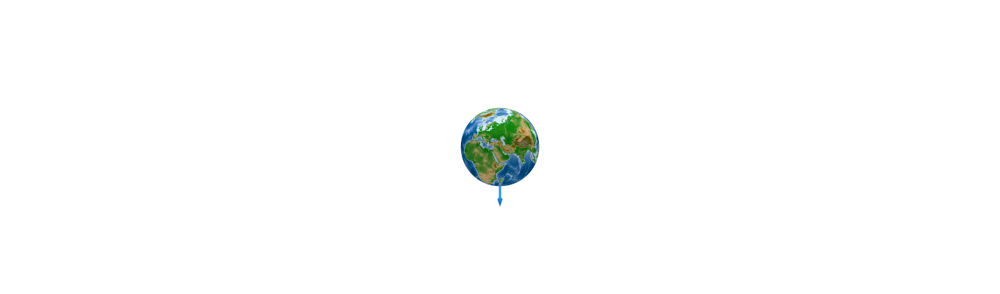

In [6]:
from analysis.plot_globe_direction import plot_direction_from_earth

# earth coordinates:
long = 0.0
lat = -90.0

# neutrino direction coordinates:
azi = 0.0
zen = 0.0

fig = plot_direction_from_earth(long=long, lat=lat, azi=azi, zen=zen)
fig.show()

In [12]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from ipywidgets import interact, FloatSlider
from IPython.display import display, clear_output

# make your own colormap 

#fill in with a number between 0 and 1

green = 0.2 
red = 0.2
blue = 0.4

from matplotlib import cm 
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
N = 20
vals = np.ones((N, 4))
vals[:, 0] = red
vals[:, 1] = green
vals[:, 2] = blue
newcmp = ListedColormap(vals[::-1])

# fig = plt.figure(figsize = (8,8))
# ax = fig.add_subplot(projection='3d')
# ax.set_box_aspect((1,1,0.6))

# # draw sphere
# u, v = np.mgrid[0:2*np.pi:200j, 0:np.pi/2:200j]
# x = np.cos(u)*np.sin(v)
# y = np.sin(u)*np.sin(v)
# z = np.cos(v)

# ax.plot_surface(x, y, z, color=newcmp(0.2), alpha=0.2)
# ax.plot_wireframe(x, y, z, color=newcmp(0.2), alpha=0.2)

# ax.plot_surface(x,y,np.zeros((200,200)),color = "lightgreen",alpha = 0.4)

# #ax.quiver(0,0,0,1,1,1,length = 1/np.sqrt(3),arrow_length_ratio = 0.2)
# ax.quiver(0,0,0,0,0,1,length = 1,arrow_length_ratio = 0.2)
# ax.quiver(0,0,0,0,1,0,length = 1,arrow_length_ratio = 0.2)
# ax.quiver(0,0,0,1,0,0,length = 1,arrow_length_ratio = 0.2)

# ax.scatter([0], [0], [0], color="orchid", s=100)

# # adjust the main plot to make room for the sliders
# fig.subplots_adjust(bottom=0.25)

# zenith = FloatSlider(min=0, max=3.14, step=0.01, value=0, description='zenith')
# azimuth = FloatSlider(min=-3.14, max=3.14, step=0.01, value=0, description='azimuth')

# def coordinates(zenith,azimuth):
#     theta = np.pi - zenith
#     phi = (azimuth - np.pi)

#     return np.sin(theta)*np.cos(phi),np.sin(theta)*np.sin(phi),np.cos(theta)

# def plot_arrow(z,a): 

#     clear_output()
#     x = coordinates(z,a)[0]
#     y = coordinates(z,a)[1]
#     c = coordinates(z,a)[2]
#     mag = np.sqrt(x**2+y**2+c**2)
#     ax.quiver(0,0,0,x/mag,y/mag,c/mag,color = "purple")
#     display(fig)

# interact(plot_arrow,
#          z = zenith,a = azimuth,continuous_update = True)

# #still need to add skymap showing coordinate maps along with text blurb & coordinate adjusting bars

## Where is the Moon ?

In [13]:
from analysis import moon

t = "2020-05-21-12-00-00"
theta, phi = moon.position(t)
print(theta, phi)

t = 60_069.5
theta, phi = moon.position(t)
print(theta, phi)

90.14301229872349 227.078778726872
110.36245626657009 348.9853486710743


In [14]:
import numpy as np
from datetime import datetime
from tqdm.notebook import tqdm

start_date = "2010-11-14"
# Fill out an end date !
end_date = "2023-05-04"

dates = np.arange(start_date, end_date, dtype='datetime64[D]')

# Here we do what is called preallocating memory
# This is just a fancy way of saying lists that have the
# correct length and then fill them with the correct values
# later. For reasons we won't get into, this can be much faster
moon_zeniths = np.zeros(len(dates))
moon_azimuths = np.zeros(len(dates))

# Now we iterate over all the dates, and calculate the moon position for each
for idx, date in tqdm(enumerate(dates)):
    zen, az = moon.position(str(date))
    moon_zeniths[idx] = zen
    moon_azimuths[idx] = az
    
    # Put the azimuth in the correct array :-)
    # moon_azimuths[idx] = az

0it [00:00, ?it/s]

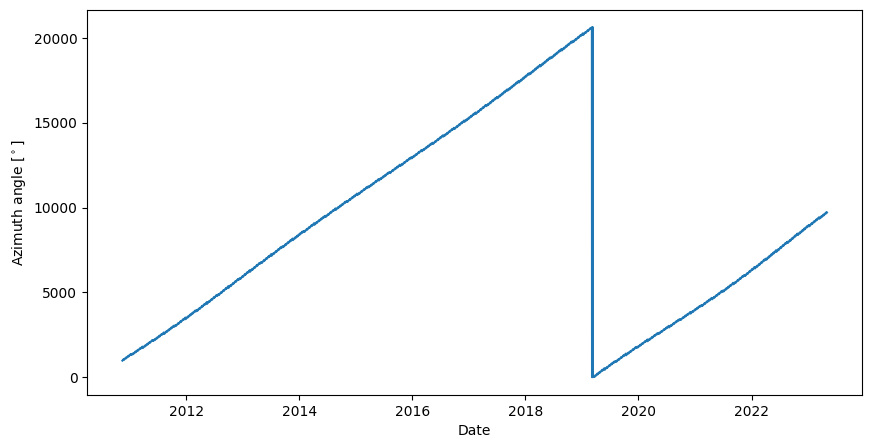

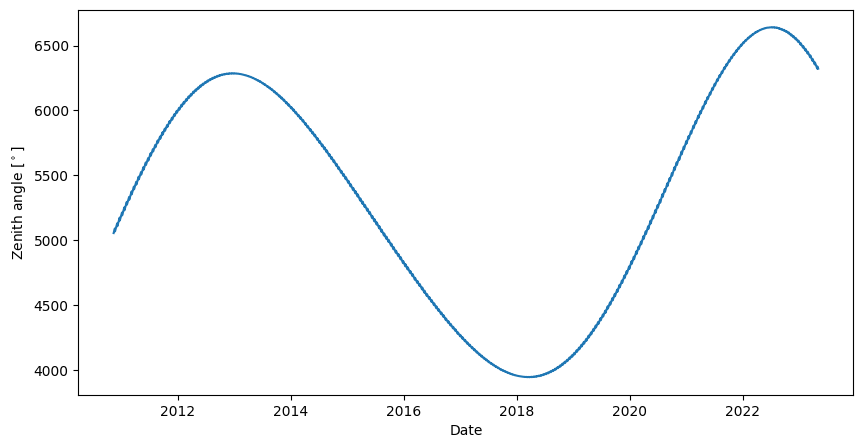

In [15]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10,5))
plt.plot(dates, np.degrees(moon_azimuths))
plt.xlabel("Date")
plt.ylabel(r"Azimuth angle [$^\circ$]")
plt.show()

# Your turn to make the zenith plot.
# Don't forget to label you axes !!!

fig, ax = plt.subplots(figsize=(10,5))
plt.plot(dates, np.degrees(moon_zeniths))
plt.xlabel("Date")
plt.ylabel(r"Zenith angle [$^\circ$]")
plt.show()

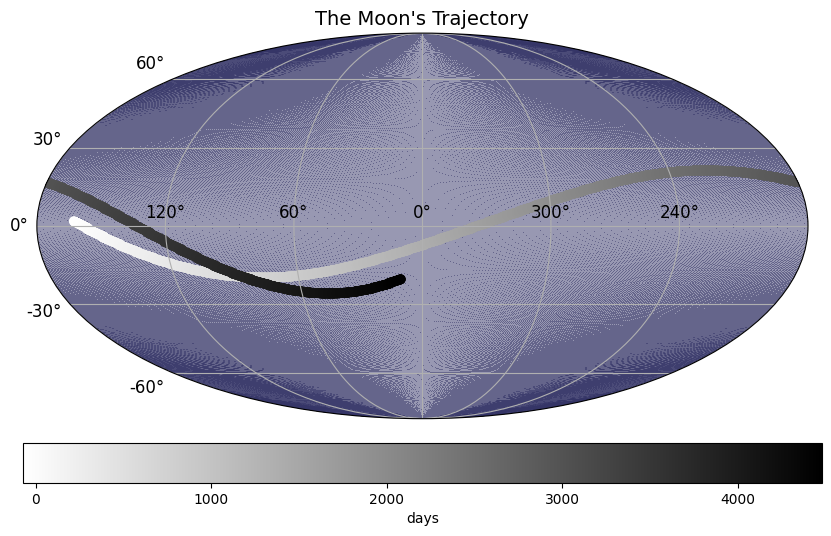

In [16]:
# make a skymap plotting the moon's trajectory 

import healpy as hp 
from healpy.newvisufunc import projview, newprojplot
from healpy.visufunc import projscatter
from healpy.visufunc import projplot

moon_theta = np.pi - np.radians(moon_zeniths)
moon_phi = (np.radians(moon_azimuths) - np.pi)

n = 25

pix0 = hp.ang2pix(n, moon_theta, moon_phi)
m = np.ones(hp.nside2npix(n))

hp.projview(m, coord = ["C"],title="The Moon's Trajectory",cmap = newcmp,cbar = False,min = 0,max = 4,
            graticule = True,graticule_labels = True,alpha = 0.5)
plt.scatter(moon_phi,moon_theta-np.pi/2,c = dates-15000,cmap = "binary")
plt.colorbar(orientation="horizontal", label="days", pad=0.05) #need to put dates in the correct format
plt.show()

In [17]:
from analysis import DataReader
tracks = DataReader("../tracks.parquet")

  0%|          | 0/82079 [00:00<?, ?it/s]

In [18]:
#@title Run me!
import numpy as np
from analysis.interactive_plot import plot_interactive_event


# from google.colab import output
# output.enable_custom_widget_manager()

from IPython.display import display, clear_output

event_list = np.array([18973, 25456, 80336, 24, 18901, 172, 47547, 5717, 831, 696, 82031, 3458, 755, 58125, 385])

def calculate_angular_difference(zenith1, azimuth1, zenith2, azimuth2):
    # Convert angles to Cartesian coordinates
    cartesian1 = np.array([
        np.sin(zenith1) * np.cos(azimuth1),
        np.sin(zenith1) * np.sin(azimuth1),
        np.cos(zenith1)
    ])
    cartesian2 = np.array([
        np.sin(zenith2) * np.cos(azimuth2),
        np.sin(zenith2) * np.sin(azimuth2),
        np.cos(zenith2)
    ])

    # Normalize vectors to unit length
    cartesian1 /= np.linalg.norm(cartesian1)
    cartesian2 /= np.linalg.norm(cartesian2)

    # Calculate dot product
    dot_product = np.dot(cartesian1, cartesian2)

    # Calculate angular difference (in radians)
    angular_difference_rad = np.arccos(dot_product)

    # Convert to degrees
    angular_difference_deg = np.degrees(angular_difference_rad)

    return angular_difference_deg

from ipywidgets import interact, interactive, FloatSlider, Dropdown, Button, Layout
from plotly.subplots import make_subplots

# event_id = Dropdown(value='38', options= ['38'], description='event_id', disabled=False)
event_id = Dropdown(value='18973', options= [str(x) for x in event_list], description='event_id', disabled=False)

def intermediate_plot_fn(x, y, z):
    fig = plot_interactive_event(tracks._photon_info[int(x)], y, z, field='mc_truth_initial', show_truth=False)
    display(fig)

zenith = FloatSlider(min=0, max=3.14, step=0.01, value=0, description='zenith',
                     layout=Layout(width='75%'))
azimuth = FloatSlider(min=-3.14, max=3.14, step=0.01, value=0, description='azimuth',
                     layout=Layout(width='75%'))

def return_to_game(button):
    clear_output()
    submit_button = Button(description='Submit')
    submit_button.on_click(reco_results)
    interact(intermediate_plot_fn, x=event_id, y=zenith, z=azimuth, continuous_update=False)
    display(submit_button)

def reco_results(button):
    global event_id, zenith, azimuth
    x = event_id.value
    y = zenith.value
    z = azimuth.value
    clear_output()
    fig = plot_interactive_event(tracks._photon_info[int(x)], y, z, field='mc_truth_initial', show_truth=True)
    display(fig)
    true_zenith = tracks._photon_info[int(event_id.value)].mc_truth_initial.initial_state_zenith
    true_azimuth = tracks._photon_info[int(event_id.value)].mc_truth_initial.initial_state_azimuth
    ad = calculate_angular_difference(true_zenith, true_azimuth, zenith.value, azimuth.value)
    print('Your estimate was ' + str(ad) + ' degrees off the true direction.')
    button.close()
    return_button = Button(description='Return')
    return_button.on_click(return_to_game)
    display(return_button)

# submit_button = Button(description='Submit')
# submit_button.on_click(reco_results)
# interact(intermediate_plot_fn, x=event_id, y=zenith, z=azimuth, continuous_update=False)
# display(submit_button)

def f():
    submit_button = Button(description='Submit')
    submit_button.on_click(reco_results)
    interact(intermediate_plot_fn, x=event_id, y=zenith, z=azimuth, continuous_update=False)
    display(submit_button)
    
f()

interactive(children=(Dropdown(description='event_id', options=('18973', '25456', '80336', '24', '18901', '172…

Button(description='Submit', style=ButtonStyle())

## Let's see if we can see the Moon !

First, we will need to compute the position of the Moon when we observed each event. The tracks have a field `time` where we give the time we saw the event. Combine this with our `moon` position method to find the position of the Moon when we saw each event.

In [32]:
from tqdm import tqdm
moon_zeniths = []
moon_azimuths = []

for time in tqdm(tracks["time"]):
    
    zen, az = moon.position(time)
    # zen, az = 
    moon_zeniths.append(zen)
    # Now do it for the azimuth
    moon_azimuths.append(az)

100%|██████████| 82079/82079 [00:14<00:00, 5792.39it/s]


In [33]:
delta_zeniths = []
for zenith, moon_zenith in zip(tracks["zenith"], moon_zeniths):
    delta_zenith = zenith - moon_zenith
    delta_zeniths.append(delta_zenith)

### Can you do the same for azimuths ?

There is a subtlety here that comes from the periodic nature of the azimuth anlge. Do you see what this is ? Can you think of a way to address this ? Maybe discuss with other students or talk to one of the instructors.

In [34]:
# This will be blank in the final version.
delta_azimuths = []

for azimuth, moon_azimuth in zip(tracks["azimuth"], moon_azimuths):
    delta_az = azimuth - moon_azimuth
    if delta_az < -180:
        delta_az += 360
    elif delta_az > 180:
        delta_az -= 360
    delta_azimuths.append(delta_az)

### Let's plot a histogram of the angular distance from the center of the Moon.

We will use a histogram for this, which is one of particle physicists favorite tools for looking at data. It will tell you how many events fall within a certain range of values. Experiment with different number of bins in each direction, and try to see if you can understand the tradeoff of having either too many bins or too few. If you want to personalize your plot, you can change the colormap that is used by changing the `cmap` keyword argument. You can find a loit of allowed colormaps [here](https://matplotlib.org/stable/tutorials/colors/colormaps.html).

In [35]:
import numpy as np
minimum_angle = -5 # degrees
maximum_angle = 5 # degrees
n_bins = 30
# n_bins = 
angle_bins = np.linspace(minimum_angle, maximum_angle, n_bins+1)

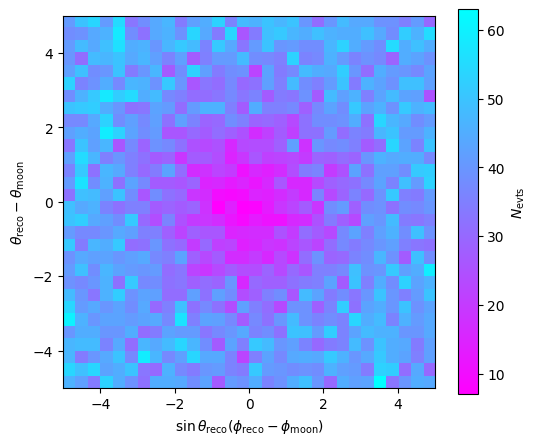

In [36]:
from analysis import sine, make_plot

h, _, _ = np.histogram2d(
    sine(tracks["zenith"]) * delta_azimuths,
    delta_zeniths,
    bins=[angle_bins, angle_bins]
)

make_plot(h, angle_bins, cmap="cool_r")

In [37]:
np.sum(tracks._mask)

82079

## Investigation into the dependence on energy



In [38]:
event_list = [18973, 25456, 80336, 24, 18901, 172, 47547, 5717, 831, 696, 82031, 3458, 755, 58125, 385]
energies = []
# go over each event_id in the event_list
for event_id in event_list:
    event = tracks[event_id] # extract the event from the data
    energies.append(event.energy) # access the neutrino energy of the event, and store it in the energies list
    print(event_id, event.energy)
# print(energies) # print out all the energies (in order)

18973 38136.79305085911
25456 72697.71172082746
80336 500.00111017182735
24 1565.3808209973497
18901 48016.78783169964
172 1214.68128365964
47547 500.0055470217293
5717 45738.994033637166
831 2157.3312014179505
696 1028.5017600051399
82031 39585.57904717526
3458 500.031646132291
755 572.8338978646908
58125 40547.327758242165
385 922.9886662883291
